## IMPORT LIABRARY

In [1]:
pip install pandas


Note: you may need to restart the kernel to use updated packages.


In [2]:
!pip install nltk
!pip install emoji
!pip install demoji
!pip install clean-text
#installing different library of python

In [7]:
import pandas as pd
import re
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer
nltk.download('stopwords')
nltk.download('punkt')
nltk.download('averaged_perceptron_tagger')#Downloading different library
nltk.download('wordnet')
nltk.download('vader_lexicon')

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\AMBUJ\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\AMBUJ\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     C:\Users\AMBUJ\AppData\Roaming\nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\AMBUJ\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package vader_lexicon to
[nltk_data]     C:\Users\AMBUJ\AppData\Roaming\nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!


True

## IMPORT DATASETS

In [8]:
df = pd.read_csv('reviews.csv')# import rawdata 

In [5]:
print(df.head())#show data

                               reviewId       userName  \
0  0197c118-5c6f-4a7b-894c-970023d1a350        Mar Zur   
1  94868fb5-a21d-4ef9-ab85-81b2ed3d0785   Devin Rivera   
2  825da34e-f65d-4ef3-991d-02d5291820d6  Heidi Kinsley   
3  a49c2875-651a-4c33-b79c-5813780d659e  Daniel Keller   
4  9482c75e-2e63-46ab-8c94-47273dd6a829  A Google user   

                                           userImage  \
0  https://play-lh.googleusercontent.com/a/ACg8oc...   
1  https://play-lh.googleusercontent.com/a-/ALV-U...   
2  https://play-lh.googleusercontent.com/a/ACg8oc...   
3  https://play-lh.googleusercontent.com/a/ACg8oc...   
4  https://play-lh.googleusercontent.com/EGemoI2N...   

                                             content  thumbsUpCount  \
0  I have the same recurring tasks to do every da...             11   
1  Instead of shopping around, I downloaded Any.d...              8   
2  Why does every once in a while... out of the b...              6   
3  Terrible Update! This app u

## CONVERTING DATASETS IN LOWER CASE

In [13]:
df['content'] = df['content'].str.lower()# convert upper case to lower case

## REMOVE LINKS

In [14]:
text = "" 
url_pattern = r"http[s]?://\S+"
text = re.sub(url_pattern, "", text)
html_link_pattern = r"<a href=\".*?\">.*?</a>"# remove html link
text = re.sub(html_link_pattern, "", text)

## REMOVE NEXT LINE

In [15]:
df['content'] = df['content'].str.replace('\n','')# remove next line using str.replace function

## WORDS CONTAINING NUMBERS

In [16]:
def remove_words_with_numbers(text):
    
    pattern = r'\b(?:\w*\d\w*|\d+)\b'
    
    return re.sub(pattern, '', text)
cleaned_text = remove_words_with_numbers(text) # cleaned data which contain number
print(cleaned_text)

## Remove Extra Character

In [11]:
df['content'] = df['content'].str.strip().str.replace(r'[^\w\s]', '')

## Remove special character

In [10]:
df['content'] = df['content'].astype(str)
df['content']=df['content'].apply(lambda x: ' '.join(x.split()))

## Remove stop word

In [19]:

stop_words = set(stopwords.words('english'))
words = [word.lower() for word in words if word.isalpha() and word.lower() not in stop_words]
#by using inbuilt libraies
from nltk.corpus import stopwords
stop_words = stopwords.words('english')
new_stopwords = ["would","shall","could","might"] 
stop_words.extend(new_stopwords)
stop_words.remove("not")
stop_words=set(stop_words)


## Remove Emoji

In [18]:
import pandas as pd
import demoji



text = ' '.join(df['content'].astype(str))

# Function to remove emojis from text
def remove_emojis(text):
    return demoji.replace(text, '')

# Remove emojis from the 'content' column
df['content'] = df['content'].apply(remove_emojis)



## LEMATIZATION

In [ ]:
from nltk.stem import WordNetLemmatizer
lemmatizer = WordNetLemmatizer()# Lematization process using WordNetLemmatizer
def lemmatize_words(text):
    words = nltk.word_tokenize(text)
    lemmatized_words = [lemmatizer.lemmatize(word) for word in words]
    return ' '.join(lemmatized_words)
df['content'] = df['content'].apply(lemmatize_words)


## STEMMING

In [14]:
from nltk.stem import PorterStemmer
porter = PorterStemmer()


def apply_stemming(text):
    tokens = word_tokenize(text)
    stemmed_tokens = [porter.stem(token) for token in tokens]
    return ' '.join(stemmed_tokens)


df['content'] = df['content'].apply(apply_stemming)




## Word Cloud

In [ ]:
!pip install pandas wordcloud
import pandas as pd               #A word cloud is a technique to show which words are the most frequent in the given text.
from wordcloud import WordCloud
import matplotlib.pyplot as plt


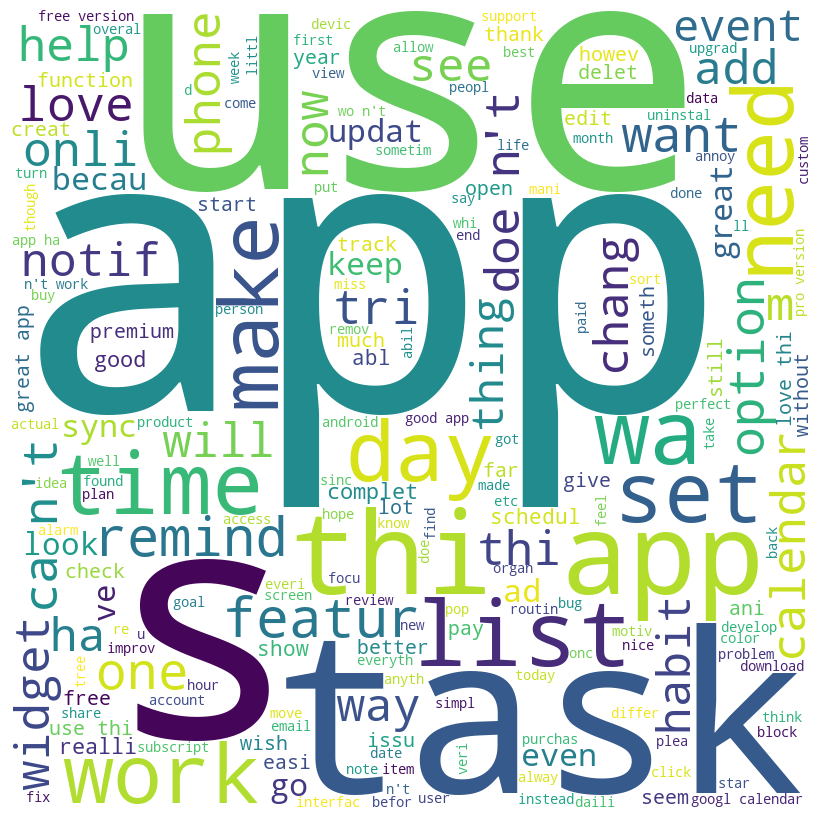

In [23]:

from wordcloud import WordCloud
import matplotlib.pyplot as plt




#Concatenate text from the 'content' column
text = ' '.join(df['content'].astype(str))

#Generate word cloud
wordcloud = WordCloud(width=800, height=800, background_color='white', min_font_size=10).generate(text)

# Display word cloud
plt.figure(figsize=(8, 8), facecolor=None)
plt.imshow(wordcloud)
plt.axis("off")
plt.tight_layout(pad=0)

plt.show()


## Frequency of word used

In [27]:

from collections import Counter
import string




# Concatenate text from the 'content' column
text = ' '.join(df['content'].astype(str))

# Tokenize the text (split into words)
words = word_tokenize(text)

# Remove punctuation and stopwords
stop_words = set(stopwords.words('english'))
words = [word.lower() for word in words if word.isalpha() and word.lower() not in stop_words]

# Count word frequencies
word_freq = Counter(words)

# Display the top N words and their frequencies
top_n = 10  # Change this value to display more or fewer top words
print("Top", top_n, "words used:")
for word, freq in word_freq.most_common(top_n):
    print(f"{word}: {freq} times")
##No of text lenght
df['content'].str.len().describe()

Top 10 words used:
app: 16281 times
thi: 9808 times
use: 6779 times
task: 6234 times
like: 4102 times
time: 4077 times
work: 3705 times
list: 3378 times
would: 3352 times
wa: 3235 times


count    16787.000000
mean       232.586466
std        168.468568
min          0.000000
25%         86.000000
50%        208.000000
75%        379.000000
max       2472.000000
Name: content, dtype: float64

## Lexicon

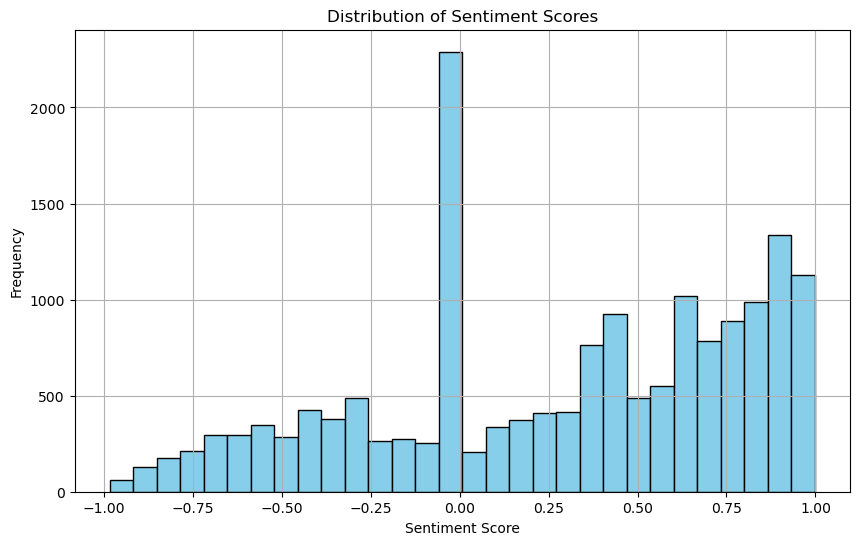

In [33]:
import pandas as pd
from nltk.sentiment.vader import SentimentIntensityAnalyzer
import matplotlib.pyplot as plt



# Step 2: Initialize Vader Sentiment Analyzer
sid = SentimentIntensityAnalyzer()

# Step 3: Function to get sentiment score
def get_sentiment_score(text):
    return sid.polarity_scores(text)['compound']

# Step 4: Perform sentiment analysis and add sentiment scores to DataFrame
df['sentiment_score'] = df['content'].apply(get_sentiment_score)

# Step 5: Plot the histogram of sentiment scores
plt.figure(figsize=(10, 6))
plt.hist(df['sentiment_score'], bins=30, color='skyblue', edgecolor='black')
plt.title('Distribution of Sentiment Scores')
plt.xlabel('Sentiment Score')
plt.ylabel('Frequency')
plt.grid(True)
plt.show()


## Sentiment scores obtained from the Afinn sentiment analysis

In [35]:
!pip install afinn 
from afinn import Afinn
afinn = Afinn()
def get_afinn_score(text): ## getting score
    return afinn.score(text)

def get_sentiment_label(score): ## setting labels
    if score > 0:
        return 'positive'
    elif score < 0:                   #sentiment scores obtained from the Afinn sentiment analysis
        return 'negative'
    else:
        return 'neutral'


     ---------------------------------------- 0.0/52.6 kB ? eta -:--:--
     ------- -------------------------------- 10.2/52.6 kB ? eta -:--:--
     ---------------------- --------------- 30.7/52.6 kB 262.6 kB/s eta 0:00:01
     -------------------------------------- 52.6/52.6 kB 338.8 kB/s eta 0:00:00
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
  Created wheel for afinn: filename=afinn-0.1-py3-none-any.whl size=53439 sha256=3cee2d14b4bf1d2d79dcb1761646912d1061042c72953ffac86048b0c4acc6fe
  Stored in directory: c:\users\ambuj\appdata\local\pip\cache\wheels\ee\d3\a0\f9255ebac29886acb1c28b35b37523f6399677fa06be379f25
Successfully built afinn


In [37]:
df['sentiment_score_afinn'] = df['content'].apply(get_afinn_score)
df['sentiment_label_afinn'] = df['sentiment_score_afinn'].apply(get_sentiment_label)
sentiment_df=df[['content','sentiment_label_afinn','sentiment_score_afinn','appId']]


,content,sentiment_label_afinn,sentiment_score_afinn,appId
0,i have the same recur task to do everi day . i...,negative,-4.0,com.anydo
1,"instead of shop around , i download any.do bec...",positive,1.0,com.anydo
2,whi doe everi onc in a while ... out of the bl...,negative,-6.0,com.anydo
3,terribl updat ! thi app use to be perfect for ...,positive,6.0,com.anydo
4,thi app is deceivingli terribl . there are som...,positive,3.0,com.anydo
5,smart groceri list from hell . while it might ...,negative,-1.0,com.anydo
6,wunderlist wa everyth i need and i had no issu...,positive,4.0,com.anydo
7,i have had thi app for almost a year . i wa re...,neutral,0.0,com.anydo
8,almost perfect but the develop choos to ignor ...,negative,-2.0,com.anydo
9,veri annoy that i have to keep sign in and the...,positive,1.0,com.anydo


## Vader sentiment analysis

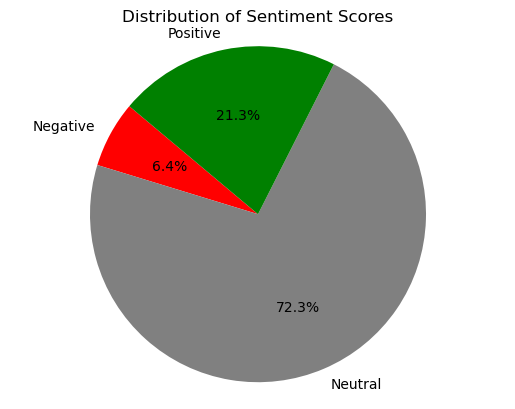

In [22]:
sid = SentimentIntensityAnalyzer()

# Function to analyze sentiment
def analyze_sentiment(text):
    tokens = word_tokenize(text)
    stop_words = set(stopwords.words('english'))
    filtered_tokens = [word for word in tokens if word.lower() not in stop_words]
    scores = sid.polarity_scores(' '.join(filtered_tokens))
    return scores

# Apply sentiment analysis to the 'content' column
df['sentiment_scores'] = df['content'].apply(lambda x: analyze_sentiment(str(x)))

# Extract sentiment scores into separate columns
df['neg'] = df['sentiment_scores'].apply(lambda x: x['neg'])
df['neu'] = df['sentiment_scores'].apply(lambda x: x['neu'])
df['pos'] = df['sentiment_scores'].apply(lambda x: x['pos'])
df['compound'] = df['sentiment_scores'].apply(lambda x: x['compound'])

# Get total count of each sentiment category
total_neg = df['neg'].sum()
total_neu = df['neu'].sum()
total_pos = df['pos'].sum()

# Create a pie chart
labels = ['Negative', 'Neutral', 'Positive']
sizes = [total_neg, total_neu, total_pos]
colors = ['red', 'gray', 'green']
plt.pie(sizes, labels=labels, colors=colors, autopct='%1.1f%%', startangle=140)
plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.
plt.title('Distribution of Sentiment Scores')
plt.show()

In [4]:
## Vader sentiment analysis on each row

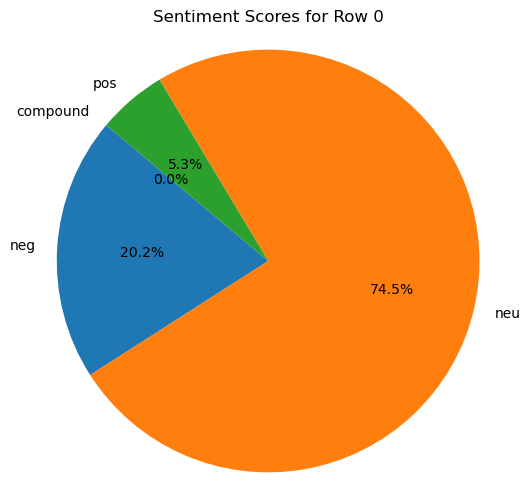

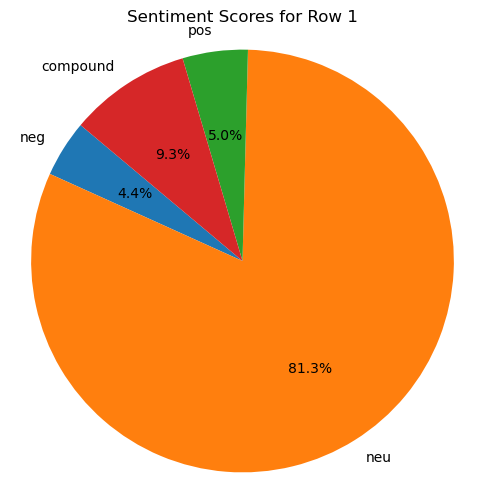

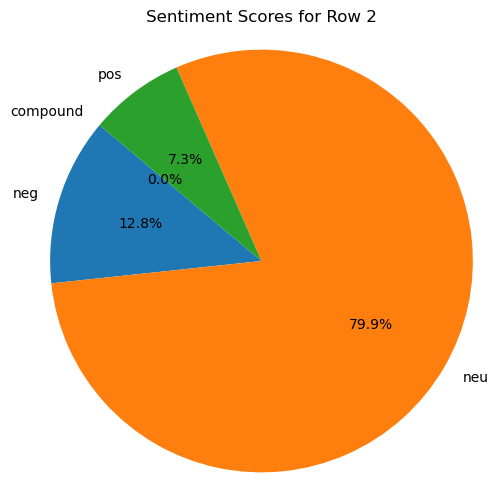

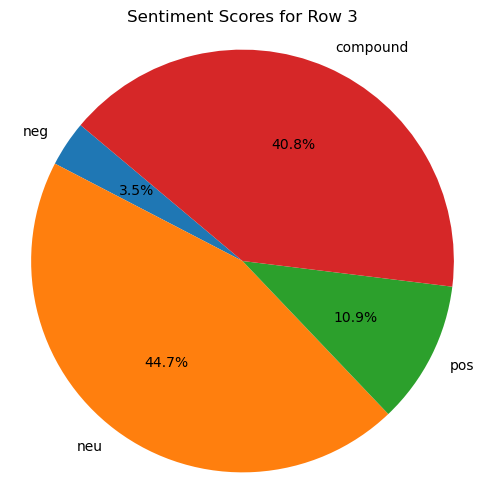

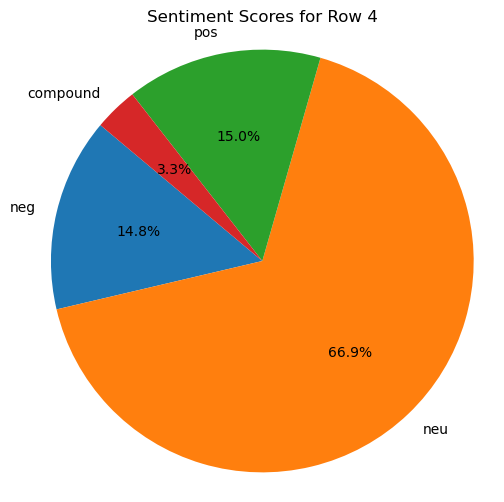

...

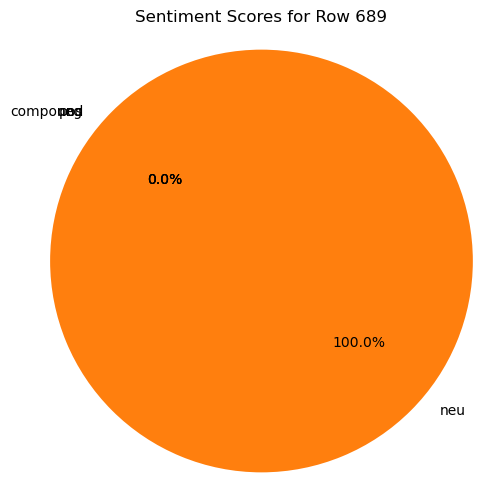

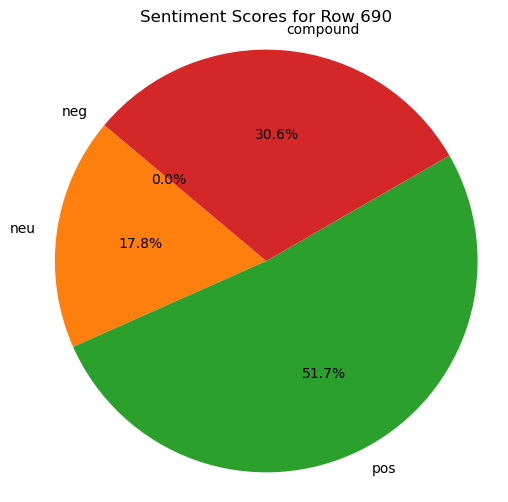

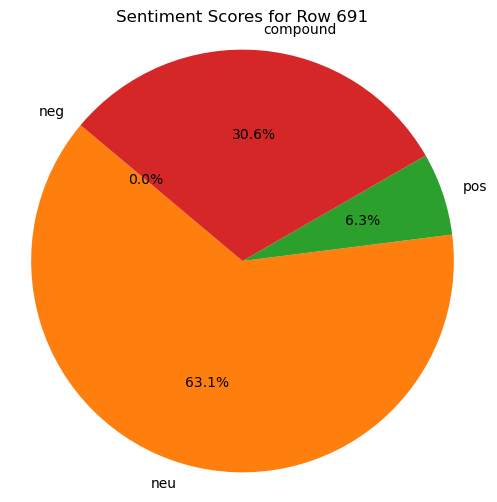

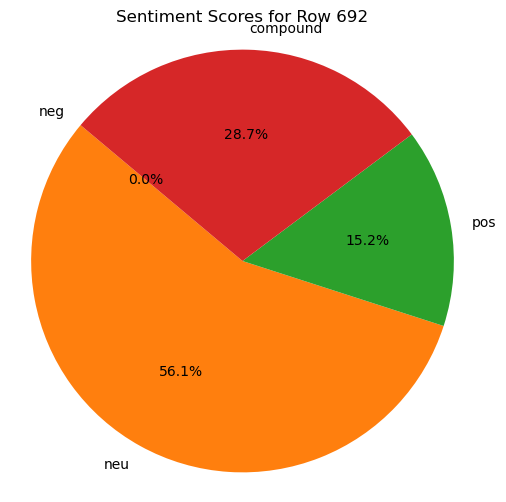

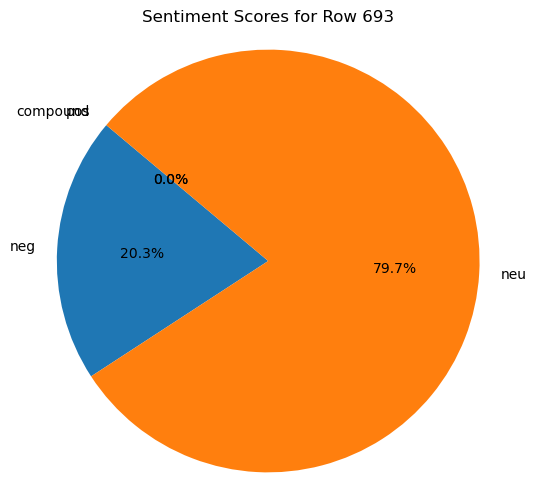

C:\Users\AMBUJ\anaconda3\Lib\site-packages\matplotlib\axes\_axes.py:3229: RuntimeWarning: invalid value encountered in divide
  x = x / sx


ValueError: cannot convert float NaN to integer

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values


ValueError: need at least one array to concatenate

<Figure size 600x600 with 1 Axes>

In [24]:
sid = SentimentIntensityAnalyzer()

# Function to analyze sentiment
def analyze_sentiment(text):
    tokens = word_tokenize(text)
    stop_words = set(stopwords.words('english'))
    filtered_tokens = [word for word in tokens if word.lower() not in stop_words]
    scores = sid.polarity_scores(' '.join(filtered_tokens))
    return scores

# Apply sentiment analysis to the 'content' column
df['sentiment_scores'] = df['content'].apply(lambda x: analyze_sentiment(str(x)))

# Plot pie chart for each row
for index, row in df.iterrows():
    sentiment_scores = row['sentiment_scores']
    labels = list(sentiment_scores.keys())
    values = list(sentiment_scores.values())
    
    # Ensure values are non-negative
    values = [max(0, v) for v in values]
    
    plt.figure(figsize=(6, 6))
    plt.pie(values, labels=labels, autopct='%1.1f%%', startangle=140)
    plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.
    plt.title(f'Sentiment Scores for Row {index}')
    plt.show()

## Export pre processing data

In [ ]:
df.to_csv('DataPreProcessed.csv', index=False)